In [1]:
##importing libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")

In [3]:
import plotly.express as px
import plotly.graph_objects as go


In [4]:
##reading datasets
data1=pd.read_csv('time_series_covid19_confirmed_global.csv')

In [5]:
data2=pd.read_csv('time_series_covid19_deaths_global.csv')

In [6]:
data3=pd.read_csv('time_series_covid19_recovered_global.csv')

In [7]:
##checking the shape of the data
print(data1.shape)
print(data2.shape)
print(data3.shape)

(266, 248)
(266, 248)
(253, 248)


In [8]:
##sorting the values
data1 = data1.sort_values(by=['Province/State'])
data1 = data1.reset_index(drop=True)

In [9]:
data2= data2.sort_values(by=['Province/State'])
data2= data2.reset_index(drop=True)

In [10]:
data3 = data3.sort_values(by=['Province/State'])
data3 = data3.reset_index(drop=True)


In [11]:
##taking the differences between the datasets
d1= data1[["Province/State","Country/Region"]]
d2= data2[["Province/State","Country/Region"]]
data_diff = pd.concat([d1,d2]).drop_duplicates(keep=False)
data_diff

,Province/State,Country/Region


In [12]:
dates1 = data1.columns[4:]
dates2 = data2.columns[4:]
print(dates1)
print(dates2)

Index(['1/22/20', '1/23/20', '1/24/20', '1/25/20', '1/26/20', '1/27/20',
       '1/28/20', '1/29/20', '1/30/20', '1/31/20',
       ...
       '9/12/20', '9/13/20', '9/14/20', '9/15/20', '9/16/20', '9/17/20',
       '9/18/20', '9/19/20', '9/20/20', '9/21/20'],
      dtype='object', length=244)
Index(['1/22/20', '1/23/20', '1/24/20', '1/25/20', '1/26/20', '1/27/20',
       '1/28/20', '1/29/20', '1/30/20', '1/31/20',
       ...
       '9/12/20', '9/13/20', '9/14/20', '9/15/20', '9/16/20', '9/17/20',
       '9/18/20', '9/19/20', '9/20/20', '9/21/20'],
      dtype='object', length=244)


In [13]:
##melting the data
data1_melted = data1.melt(id_vars=['Province/State', 'Country/Region', 'Lat', 'Long'], 
                              value_vars=dates1, 
                              var_name='Date',
                              value_name='Confirmed')
data1_melted


,Province/State,Country/Region,Lat,Long,Date,Confirmed
0,Alberta,Canada,53.933300,-116.576500,1/22/20,0
1,Anguilla,United Kingdom,18.220600,-63.068600,1/22/20,0
2,Anhui,China,31.825700,117.226400,1/22/20,1
3,Aruba,Netherlands,12.521100,-69.968300,1/22/20,0
4,Australian Capital Territory,Australia,-35.473500,149.012400,1/22/20,0
...,...,...,...,...,...,...
64899,NaN,West Bank and Gaza,31.952200,35.233200,9/21/20,36151
64900,NaN,Western Sahara,24.215500,-12.885800,9/21/20,10
64901,NaN,Yemen,15.552727,48.516388,9/21/20,2028
64902,NaN,Zambia,-13.133897,27.849332,9/21/20,14175


In [14]:
data2_melted = data2.melt(id_vars=['Province/State', 'Country/Region', 'Lat', 'Long'],                                
                                value_vars=dates2,
                                var_name='Date', 
                                value_name='Deaths')
data2_melted

,Province/State,Country/Region,Lat,Long,Date,Deaths
0,Alberta,Canada,53.933300,-116.576500,1/22/20,0
1,Anguilla,United Kingdom,18.220600,-63.068600,1/22/20,0
2,Anhui,China,31.825700,117.226400,1/22/20,0
3,Aruba,Netherlands,12.521100,-69.968300,1/22/20,0
4,Australian Capital Territory,Australia,-35.473500,149.012400,1/22/20,0
...,...,...,...,...,...,...
64899,NaN,West Bank and Gaza,31.952200,35.233200,9/21/20,265
64900,NaN,Western Sahara,24.215500,-12.885800,9/21/20,1
64901,NaN,Yemen,15.552727,48.516388,9/21/20,586
64902,NaN,Zambia,-13.133897,27.849332,9/21/20,331


In [15]:
##combining the melted datas using concat 
data_combined = pd.concat([data1_melted, data2_melted["Deaths"]], axis = 1, sort = False)
data_combined

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths
0,Alberta,Canada,53.933300,-116.576500,1/22/20,0,0
1,Anguilla,United Kingdom,18.220600,-63.068600,1/22/20,0,0
2,Anhui,China,31.825700,117.226400,1/22/20,1,0
3,Aruba,Netherlands,12.521100,-69.968300,1/22/20,0,0
4,Australian Capital Territory,Australia,-35.473500,149.012400,1/22/20,0,0
...,...,...,...,...,...,...,...
64899,NaN,West Bank and Gaza,31.952200,35.233200,9/21/20,36151,265
64900,NaN,Western Sahara,24.215500,-12.885800,9/21/20,10,1
64901,NaN,Yemen,15.552727,48.516388,9/21/20,2028,586
64902,NaN,Zambia,-13.133897,27.849332,9/21/20,14175,331


In [16]:
##calculating the percentage of the combined data 
data_combined["Percentage"] = data_combined["Deaths"]/data_combined["Confirmed"]
data_combined

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Percentage
0,Alberta,Canada,53.933300,-116.576500,1/22/20,0,0,NaN
1,Anguilla,United Kingdom,18.220600,-63.068600,1/22/20,0,0,NaN
2,Anhui,China,31.825700,117.226400,1/22/20,1,0,0.000000
3,Aruba,Netherlands,12.521100,-69.968300,1/22/20,0,0,NaN
4,Australian Capital Territory,Australia,-35.473500,149.012400,1/22/20,0,0,NaN
...,...,...,...,...,...,...,...,...
64899,NaN,West Bank and Gaza,31.952200,35.233200,9/21/20,36151,265,0.007330
64900,NaN,Western Sahara,24.215500,-12.885800,9/21/20,10,1,0.100000
64901,NaN,Yemen,15.552727,48.516388,9/21/20,2028,586,0.288955
64902,NaN,Zambia,-13.133897,27.849332,9/21/20,14175,331,0.023351


In [17]:
##filling the Nan values withh 0
data_combined.fillna(0, inplace=True)
data_combined

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Percentage
0,Alberta,Canada,53.933300,-116.576500,1/22/20,0,0,0.000000
1,Anguilla,United Kingdom,18.220600,-63.068600,1/22/20,0,0,0.000000
2,Anhui,China,31.825700,117.226400,1/22/20,1,0,0.000000
3,Aruba,Netherlands,12.521100,-69.968300,1/22/20,0,0,0.000000
4,Australian Capital Territory,Australia,-35.473500,149.012400,1/22/20,0,0,0.000000
...,...,...,...,...,...,...,...,...
64899,0,West Bank and Gaza,31.952200,35.233200,9/21/20,36151,265,0.007330
64900,0,Western Sahara,24.215500,-12.885800,9/21/20,10,1,0.100000
64901,0,Yemen,15.552727,48.516388,9/21/20,2028,586,0.288955
64902,0,Zambia,-13.133897,27.849332,9/21/20,14175,331,0.023351


In [18]:
##importing datetime in the specific format
import datetime
def format_time(datetime_str):    
    d = datetime.datetime.strptime(datetime_str, '%m/%d/%y')    
    return d.date()

data_combined["Date"] = data_combined["Date"].apply(format_time)
data_combined

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Percentage
0,Alberta,Canada,53.933300,-116.576500,2020-01-22,0,0,0.000000
1,Anguilla,United Kingdom,18.220600,-63.068600,2020-01-22,0,0,0.000000
2,Anhui,China,31.825700,117.226400,2020-01-22,1,0,0.000000
3,Aruba,Netherlands,12.521100,-69.968300,2020-01-22,0,0,0.000000
4,Australian Capital Territory,Australia,-35.473500,149.012400,2020-01-22,0,0,0.000000
...,...,...,...,...,...,...,...,...
64899,0,West Bank and Gaza,31.952200,35.233200,2020-09-21,36151,265,0.007330
64900,0,Western Sahara,24.215500,-12.885800,2020-09-21,10,1,0.100000
64901,0,Yemen,15.552727,48.516388,2020-09-21,2028,586,0.288955
64902,0,Zambia,-13.133897,27.849332,2020-09-21,14175,331,0.023351


In [19]:
grouped_by_date = data_combined.groupby("Date")

In [20]:
for date, group in grouped_by_date:
    print(date)
    print(group[["Province/State","Country/Region", "Confirmed", "Deaths"]])

2020-01-22
                   Province/State      Country/Region  Confirmed  Deaths
0                         Alberta              Canada          0       0
1                        Anguilla      United Kingdom          0       0
2                           Anhui               China          1       0
3                           Aruba         Netherlands          0       0
4    Australian Capital Territory           Australia          0       0
..                            ...                 ...        ...     ...
261                             0  West Bank and Gaza          0       0
262                             0      Western Sahara          0       0
263                             0               Yemen          0       0
264                             0              Zambia          0       0
265                             0            Zimbabwe          0       0

[266 rows x 4 columns]
2020-01-23
                   Province/State      Country/Region  Confirmed  Deaths
266  

                     Province/State      Country/Region  Confirmed  Deaths
16758                       Alberta              Canada        358       2
16759                      Anguilla      United Kingdom          0       0
16760                         Anhui               China        990       6
16761                         Aruba         Netherlands         17       0
16762  Australian Capital Territory           Australia         39       0
...                             ...                 ...        ...     ...
17019                             0  West Bank and Gaza         59       0
17020                             0      Western Sahara          0       0
17021                             0               Yemen          0       0
17022                             0              Zambia         12       0
17023                             0            Zimbabwe          3       1

[266 rows x 4 columns]
2020-03-26
                     Province/State      Country/Region  Confirme

                     Province/State      Country/Region  Confirmed  Deaths
32452                       Alberta              Canada       6818     135
32453                      Anguilla      United Kingdom          3       0
32454                         Anhui               China        991       6
32455                         Aruba         Netherlands        101       3
32456  Australian Capital Territory           Australia        107       3
...                             ...                 ...        ...     ...
32713                             0  West Bank and Gaza        423       3
32714                             0      Western Sahara          6       0
32715                             0               Yemen        212      39
32716                             0              Zambia        920       7
32717                             0            Zimbabwe         56       4

[266 rows x 4 columns]
2020-05-24
                     Province/State      Country/Region  Confirme

                     Province/State      Country/Region  Confirmed  Deaths
48412                       Alberta              Canada       9728     172
48413                      Anguilla      United Kingdom          3       0
48414                         Anhui               China        991       6
48415                         Aruba         Netherlands        117       3
48416  Australian Capital Territory           Australia        113       3
...                             ...                 ...        ...     ...
48673                             0  West Bank and Gaza       9398      66
48674                             0      Western Sahara         10       1
48675                             0               Yemen       1640     458
48676                             0              Zambia       3583     128
48677                             0            Zimbabwe       2034      26

[266 rows x 4 columns]
2020-07-23
                     Province/State      Country/Region  Confirme

In [21]:
##getting the day-wise data with respect to country/region
data_daily = data_combined.groupby(["Date","Country/Region"]).aggregate({'Confirmed': 'sum', 'Deaths': 'sum'})
data_daily

Confirmed  Deaths
Date       Country/Region                       
2020-01-22 Afghanistan                 0       0
           Albania                     0       0
           Algeria                     0       0
           Andorra                     0       0
           Angola                      0       0
...                                  ...     ...
2020-09-21 West Bank and Gaza      36151     265
           Western Sahara             10       1
           Yemen                    2028     586
           Zambia                  14175     331
           Zimbabwe                 7683     225

[45872 rows x 2 columns]

In [22]:
data3_melted = data3.melt(id_vars=['Province/State', 'Country/Region', 'Lat', 'Long'], 
                              value_vars=dates1, 
                              var_name='Date',
                              value_name='Recovered')
data3_melted

,Province/State,Country/Region,Lat,Long,Date,Recovered
0,Anguilla,United Kingdom,18.220600,-63.068600,1/22/20,0
1,Anhui,China,31.825700,117.226400,1/22/20,0
2,Aruba,Netherlands,12.521100,-69.968300,1/22/20,0
3,Australian Capital Territory,Australia,-35.473500,149.012400,1/22/20,0
4,Beijing,China,40.182400,116.414200,1/22/20,0
...,...,...,...,...,...,...
61727,NaN,West Bank and Gaza,31.952200,35.233200,9/21/20,24428
61728,NaN,Western Sahara,24.215500,-12.885800,9/21/20,8
61729,NaN,Yemen,15.552727,48.516388,9/21/20,1235
61730,NaN,Zambia,-13.133897,27.849332,9/21/20,13629


In [23]:
data3_melted["Date"] = data3_melted["Date"].apply(format_time)
data3_melted

,Province/State,Country/Region,Lat,Long,Date,Recovered
0,Anguilla,United Kingdom,18.220600,-63.068600,2020-01-22,0
1,Anhui,China,31.825700,117.226400,2020-01-22,0
2,Aruba,Netherlands,12.521100,-69.968300,2020-01-22,0
3,Australian Capital Territory,Australia,-35.473500,149.012400,2020-01-22,0
4,Beijing,China,40.182400,116.414200,2020-01-22,0
...,...,...,...,...,...,...
61727,NaN,West Bank and Gaza,31.952200,35.233200,2020-09-21,24428
61728,NaN,Western Sahara,24.215500,-12.885800,2020-09-21,8
61729,NaN,Yemen,15.552727,48.516388,2020-09-21,1235
61730,NaN,Zambia,-13.133897,27.849332,2020-09-21,13629


In [24]:
data3_melted.fillna(0, inplace=True)
data3_melted

,Province/State,Country/Region,Lat,Long,Date,Recovered
0,Anguilla,United Kingdom,18.220600,-63.068600,2020-01-22,0
1,Anhui,China,31.825700,117.226400,2020-01-22,0
2,Aruba,Netherlands,12.521100,-69.968300,2020-01-22,0
3,Australian Capital Territory,Australia,-35.473500,149.012400,2020-01-22,0
4,Beijing,China,40.182400,116.414200,2020-01-22,0
...,...,...,...,...,...,...
61727,0,West Bank and Gaza,31.952200,35.233200,2020-09-21,24428
61728,0,Western Sahara,24.215500,-12.885800,2020-09-21,8
61729,0,Yemen,15.552727,48.516388,2020-09-21,1235
61730,0,Zambia,-13.133897,27.849332,2020-09-21,13629


In [25]:
data3_daily= data3_melted.groupby(["Date","Country/Region"]).aggregate({'Recovered': 'sum'})
data3_daily

Recovered
Date       Country/Region               
2020-01-22 Afghanistan                 0
           Albania                     0
           Algeria                     0
           Andorra                     0
           Angola                      0
...                                  ...
2020-09-21 West Bank and Gaza      24428
           Western Sahara              8
           Yemen                    1235
           Zambia                  13629
           Zimbabwe                 5924

[45872 rows x 1 columns]

In [26]:
data3_daily.shape, data_daily.shape

((45872, 1), (45872, 2))

In [27]:
##combing all the three datasets 
data_combined_all = pd.concat([data_daily, data3_daily["Recovered"]], axis = 1, sort = False)
data_combined_all

Confirmed  Deaths  Recovered
Date       Country/Region                                  
2020-01-22 Afghanistan                 0       0          0
           Albania                     0       0          0
           Algeria                     0       0          0
           Andorra                     0       0          0
           Angola                      0       0          0
...                                  ...     ...        ...
2020-09-21 West Bank and Gaza      36151     265      24428
           Western Sahara             10       1          8
           Yemen                    2028     586       1235
           Zambia                  14175     331      13629
           Zimbabwe                 7683     225       5924

[45872 rows x 3 columns]

In [28]:
data_combined_all["Death Percentage"] = (data_combined_all["Deaths"]/data_combined_all["Confirmed"]) *100
data_combined_all["Recovery Percentage"] = (data_combined_all["Recovered"]/data_combined_all["Confirmed"]) *100
data_combined_all

Confirmed  Deaths  Recovered  Death Percentage  \
Date       Country/Region                                                       
2020-01-22 Afghanistan                 0       0          0               NaN   
           Albania                     0       0          0               NaN   
           Algeria                     0       0          0               NaN   
           Andorra                     0       0          0               NaN   
           Angola                      0       0          0               NaN   
...                                  ...     ...        ...               ...   
2020-09-21 West Bank and Gaza      36151     265      24428          0.733036   
           Western Sahara             10       1          8         10.000000   
           Yemen                    2028     586       1235         28.895464   
           Zambia                  14175     331      13629          2.335097   
           Zimbabwe                 7683     225       5924          2.928544   

                               Recovery Percentage  
Date       Country/Region                           
2020-01-22 Afghanistan                         NaN  
           Albania                             NaN  
           Algeria                             NaN  
           Andorra                             NaN  
           Angola                              NaN  
...                                            ...  
2020-09-21 West Bank and Gaza            67.572128  
           Western Sahara                80.000000  
           Yemen                         60.897436  
           Zambia                        96.148148  
           Zimbabwe                      77.105297  

[45872 rows x 5 columns]

In [29]:
data_combined_all.fillna(0, inplace=True)
data_combined_all

Confirmed  Deaths  Recovered  Death Percentage  \
Date       Country/Region                                                       
2020-01-22 Afghanistan                 0       0          0          0.000000   
           Albania                     0       0          0          0.000000   
           Algeria                     0       0          0          0.000000   
           Andorra                     0       0          0          0.000000   
           Angola                      0       0          0          0.000000   
...                                  ...     ...        ...               ...   
2020-09-21 West Bank and Gaza      36151     265      24428          0.733036   
           Western Sahara             10       1          8         10.000000   
           Yemen                    2028     586       1235         28.895464   
           Zambia                  14175     331      13629          2.335097   
           Zimbabwe                 7683     225       5924          2.928544   

                               Recovery Percentage  
Date       Country/Region                           
2020-01-22 Afghanistan                    0.000000  
           Albania                        0.000000  
           Algeria                        0.000000  
           Andorra                        0.000000  
           Angola                         0.000000  
...                                            ...  
2020-09-21 West Bank and Gaza            67.572128  
           Western Sahara                80.000000  
           Yemen                         60.897436  
           Zambia                        96.148148  
           Zimbabwe                      77.105297  

[45872 rows x 5 columns]

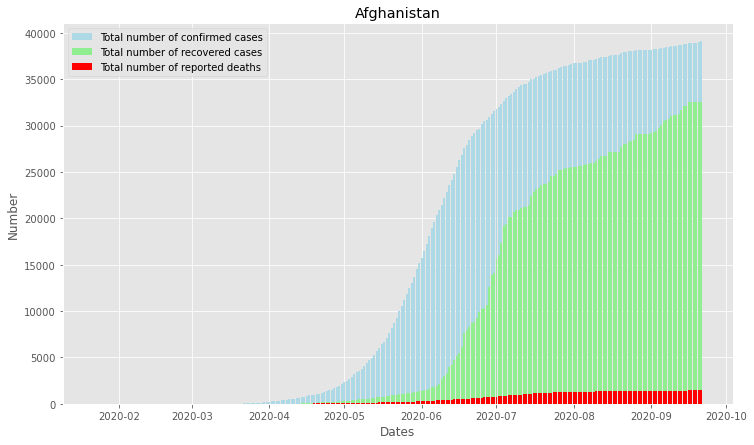

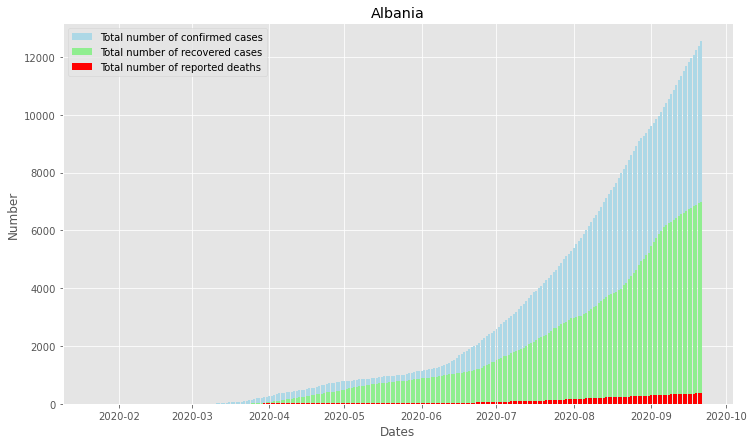

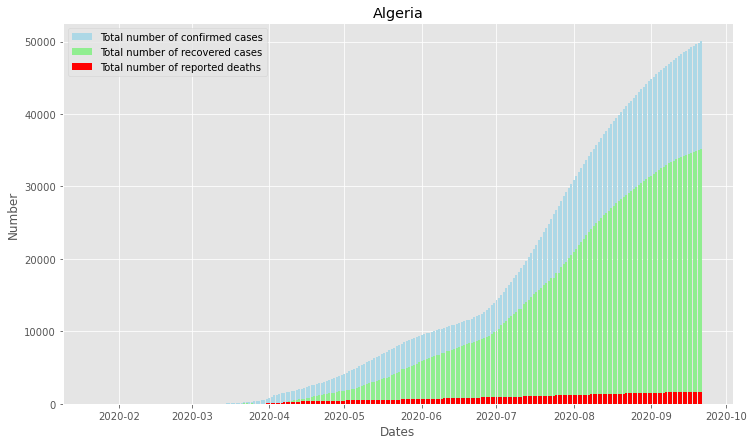

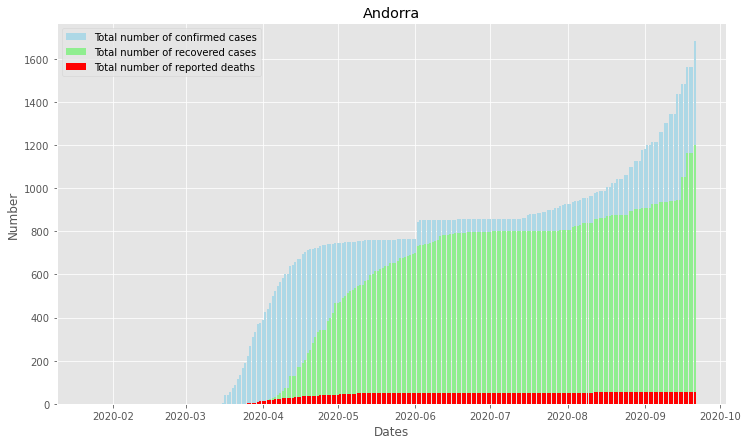

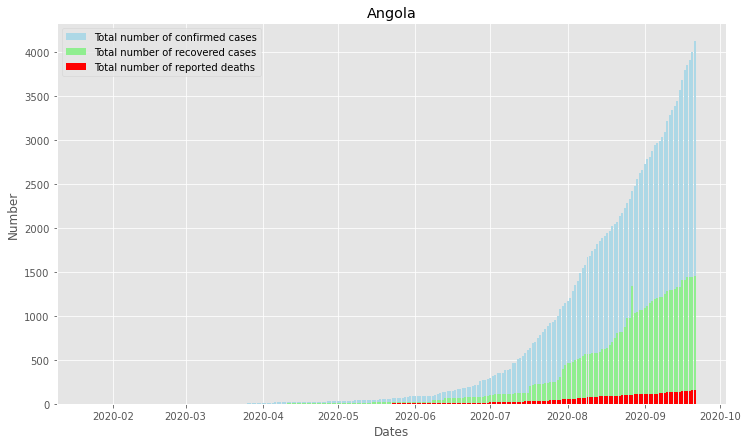

...

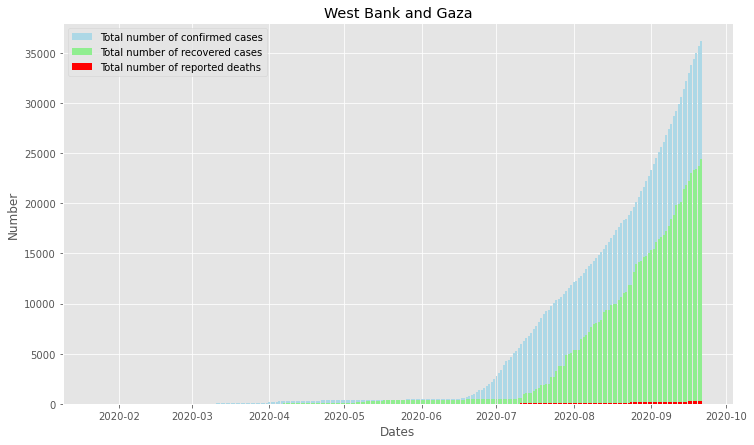

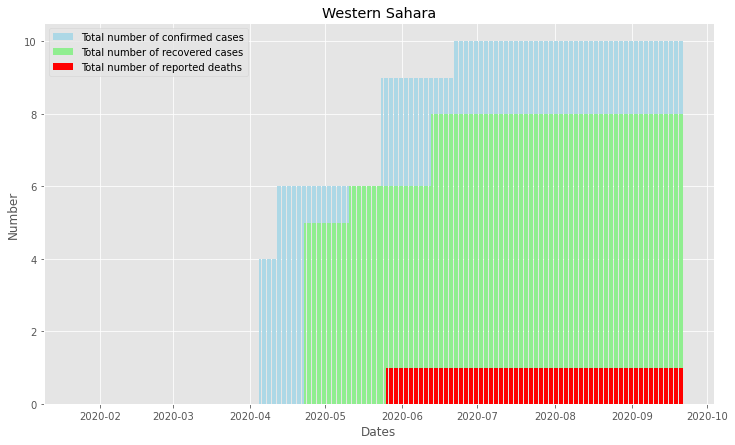

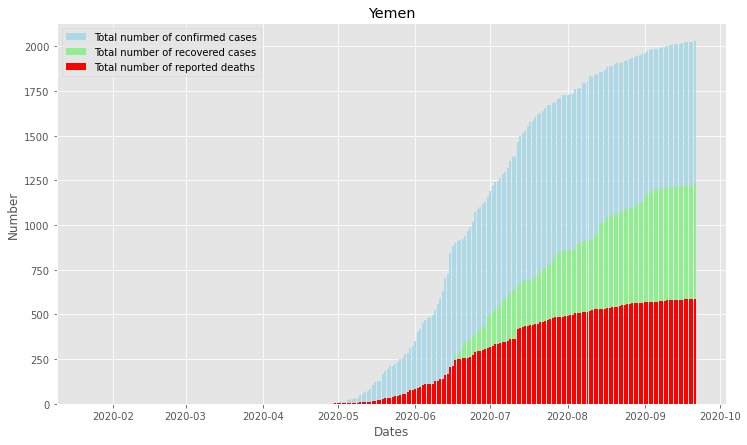

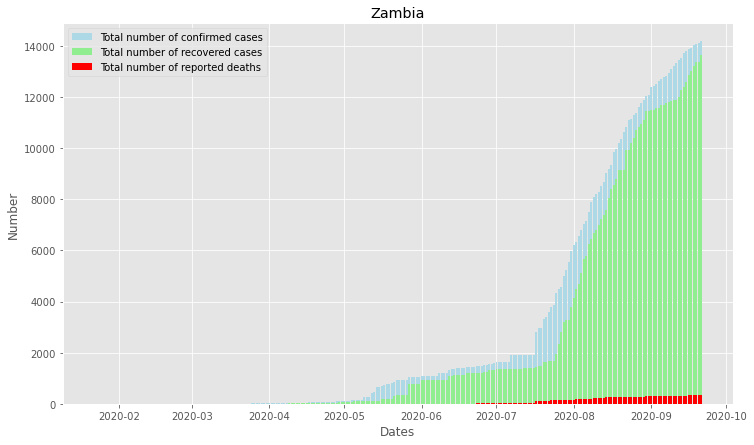

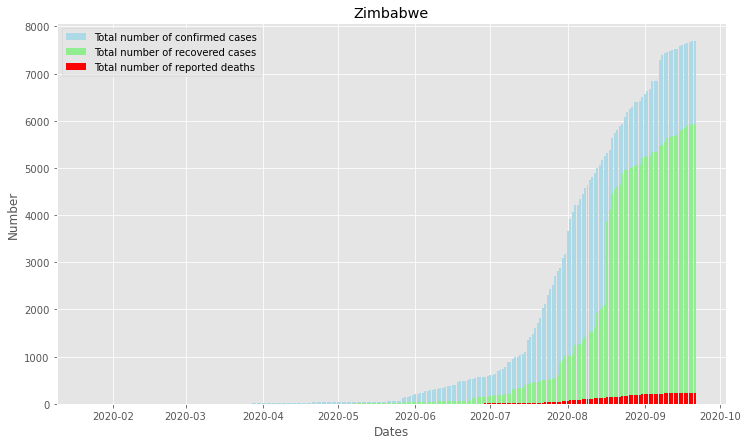

In [28]:
##implementing the grammar of the graphics plotting
import matplotlib.pyplot as plt

plt.style.use('ggplot')


for country, data_country in data_combined_all.groupby("Country/Region"):    
    dates = list(data_country.index.get_level_values('Date'))
    confirmed = list(data_country.Confirmed)
    deaths = list(data_country.Deaths)
    recovered= list(data_country.Recovered)
    plt.figure(figsize=(12,7))
    plt.bar(dates, confirmed, color='lightblue', label="Total number of confirmed cases")
    plt.bar(dates, recovered, color='lightgreen',label="Total number of recovered cases")
    plt.bar(dates, deaths, color='red',label="Total number of reported deaths")
    plt.xlabel("Dates")
    plt.ylabel("Number")
    plt.title(country)
    plt.legend()
    plt.show()


# world map

In [30]:
!pip install folium

In [31]:
##visualizing the geospatial data 
##plotting interactive maps
import folium

folium_map = folium.Map(location=[33.886917, 9.537499], zoom_start=2)
color="#E37222"
scale = 200000

In [32]:
most_recent_date = data_combined['Date'].max()
data_latest_day = data_combined[data_combined.Date==most_recent_date]

for place in data_latest_day.index:
    lat = data_latest_day.loc[place]["Lat"]
    lng = data_latest_day.loc[place]["Long"]    
    confirmed = data_latest_day.loc[place]["Confirmed"]
   
    # draw a circle on the province / state / region / country
    marker_confirmed = folium.CircleMarker(location=[lat, lng],radius=confirmed/scale,color="blue",fill=True)
    marker_confirmed.add_to(folium_map)
    
    
display(folium_map)

In [33]:
most_recent_date = data_combined['Date'].max()
data_latest_day = data_combined[data_combined.Date==most_recent_date]

for place in data_latest_day.index:
    lat = data_latest_day.loc[place]["Lat"]
    lng = data_latest_day.loc[place]["Long"]    
    deaths = data_latest_day.loc[place]["Deaths"]
   
    # draw a circle on the province / state / region / country
    marker_deaths = folium.CircleMarker(location=[lat, lng],radius=deaths/scale,color="red",fill=True)
    marker_deaths.add_to(folium_map)
    
display(folium_map)

In [39]:
most_recent_date = data_combined['Date'].max()
data_latest_day = data_combined[data_combined.Date==most_recent_date]

for place in data_latest_day.index:
    lat = data_latest_day.loc[place]["Lat"]
    lng = data_latest_day.loc[place]["Long"]    
    confirmed = data_latest_day.loc[place]["Confirmed"]
    deaths = data_latest_day.loc[place]["Deaths"]
   
    # draw a circle on the province / state / region / country
    marker_confirmed = folium.CircleMarker(location=[lat, lng],radius=confirmed/scale,color="blue",fill=True)
    marker_confirmed.add_to(folium_map)
    
    marker_deaths = folium.CircleMarker(location=[lat, lng],radius=deaths/scale,color="red",fill=True)
    marker_deaths.add_to(folium_map)
    
display(folium_map)

# EDA1(Confirmed)

In [4]:
confirm_dt = pd.read_csv("time_series_covid19_confirmed_global.csv")

In [5]:
conf_dt = confirm_dt.drop(columns = ["Province/State","Lat","Long"])
conf_dt.head()

,Country/Region,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,...,9/12/20,9/13/20,9/14/20,9/15/20,9/16/20,9/17/20,9/18/20,9/19/20,9/20/20,9/21/20
0,Afghanistan,0,0,0,0,0,0,0,0,0,...,38641,38716,38772,38815,38855,38872,38883,38919,39044,39074
1,Albania,0,0,0,0,0,0,0,0,0,...,11185,11353,11520,11672,11816,11948,12073,12226,12385,12535
2,Algeria,0,0,0,0,0,0,0,0,0,...,48007,48254,48496,48734,48966,49194,49413,49623,49826,50023
3,Andorra,0,0,0,0,0,0,0,0,0,...,1344,1344,1438,1438,1483,1483,1564,1564,1564,1681
4,Angola,0,0,0,0,0,0,0,0,0,...,3335,3388,3439,3569,3675,3789,3848,3901,3991,4117


In [6]:
conf_dt = conf_dt.groupby("Country/Region").aggregate(np.sum).T
conf_dt

Country/Region,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,Austria,...,United Kingdom,Uruguay,Uzbekistan,Venezuela,Vietnam,West Bank and Gaza,Western Sahara,Yemen,Zambia,Zimbabwe
1/22/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/23/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,2,0,0,0,0,0
1/24/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,2,0,0,0,0,0
1/25/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,2,0,0,0,0,0
1/26/20,0,0,0,0,0,0,0,0,4,0,...,0,0,0,0,2,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9/17/20,38872,11948,49194,1483,3789,95,601713,46671,26861,35853,...,384087,1876,49627,64284,1066,33843,10,2022,13928,7633
9/18/20,38883,12073,49413,1564,3848,95,613658,46910,26885,36661,...,388416,1890,50253,65174,1068,34401,10,2024,14022,7647
9/19/20,38919,12226,49623,1564,3901,96,622934,47154,26898,37474,...,392845,1904,50992,65949,1068,35003,10,2026,14070,7672
9/20/20,39044,12385,49826,1564,3991,96,631365,47431,26912,38095,...,396744,1917,51640,66656,1068,35686,10,2026,14131,7683


In [7]:
conf_dt.index.name = "Date"
conf_dt

Country/Region,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,Austria,...,United Kingdom,Uruguay,Uzbekistan,Venezuela,Vietnam,West Bank and Gaza,Western Sahara,Yemen,Zambia,Zimbabwe
Date,,,,,,,,,,,,,,,,,,,,,
1/22/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/23/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,2,0,0,0,0,0
1/24/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,2,0,0,0,0,0
1/25/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,2,0,0,0,0,0
1/26/20,0,0,0,0,0,0,0,0,4,0,...,0,0,0,0,2,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9/17/20,38872,11948,49194,1483,3789,95,601713,46671,26861,35853,...,384087,1876,49627,64284,1066,33843,10,2022,13928,7633
9/18/20,38883,12073,49413,1564,3848,95,613658,46910,26885,36661,...,388416,1890,50253,65174,1068,34401,10,2024,14022,7647
9/19/20,38919,12226,49623,1564,3901,96,622934,47154,26898,37474,...,392845,1904,50992,65949,1068,35003,10,2026,14070,7672


In [8]:
conf_dt = conf_dt.reset_index()
conf_dt

Country/Region,Date,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,...,United Kingdom,Uruguay,Uzbekistan,Venezuela,Vietnam,West Bank and Gaza,Western Sahara,Yemen,Zambia,Zimbabwe
0,1/22/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1/23/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,2,0,0,0,0,0
2,1/24/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,2,0,0,0,0,0
3,1/25/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,2,0,0,0,0,0
4,1/26/20,0,0,0,0,0,0,0,0,4,...,0,0,0,0,2,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
239,9/17/20,38872,11948,49194,1483,3789,95,601713,46671,26861,...,384087,1876,49627,64284,1066,33843,10,2022,13928,7633
240,9/18/20,38883,12073,49413,1564,3848,95,613658,46910,26885,...,388416,1890,50253,65174,1068,34401,10,2024,14022,7647
241,9/19/20,38919,12226,49623,1564,3901,96,622934,47154,26898,...,392845,1904,50992,65949,1068,35003,10,2026,14070,7672
242,9/20/20,39044,12385,49826,1564,3991,96,631365,47431,26912,...,396744,1917,51640,66656,1068,35686,10,2026,14131,7683


In [9]:
# [ melt() function is useful to massage a DataFrame into a format where one or more columns are identifier variables,
# while all other columns, considered measured variables, are unpivoted to the row axis,
# leaving just two non-identifier columns,variable and value.]
melt_conf_dt = conf_dt.melt(id_vars=["Date"],var_name="Country",value_name="Confirmed")
melt_conf_dt

,Date,Country,Confirmed
0,1/22/20,Afghanistan,0
1,1/23/20,Afghanistan,0
2,1/24/20,Afghanistan,0
3,1/25/20,Afghanistan,0
4,1/26/20,Afghanistan,0
...,...,...,...
45867,9/17/20,Zimbabwe,7633
45868,9/18/20,Zimbabwe,7647
45869,9/19/20,Zimbabwe,7672
45870,9/20/20,Zimbabwe,7683


In [10]:
melt_conf_dt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45872 entries, 0 to 45871
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Date       45872 non-null  object
 1   Country    45872 non-null  object
 2   Confirmed  45872 non-null  int64 
dtypes: int64(1), object(2)
memory usage: 1.1+ MB


In [11]:
melt_conf_dt["Date"] = pd.to_datetime(melt_conf_dt["Date"])
melt_conf_dt

,Date,Country,Confirmed
0,2020-01-22,Afghanistan,0
1,2020-01-23,Afghanistan,0
2,2020-01-24,Afghanistan,0
3,2020-01-25,Afghanistan,0
4,2020-01-26,Afghanistan,0
...,...,...,...
45867,2020-09-17,Zimbabwe,7633
45868,2020-09-18,Zimbabwe,7647
45869,2020-09-19,Zimbabwe,7672
45870,2020-09-20,Zimbabwe,7683


In [12]:
melt_conf_dt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45872 entries, 0 to 45871
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Date       45872 non-null  datetime64[ns]
 1   Country    45872 non-null  object        
 2   Confirmed  45872 non-null  int64         
dtypes: datetime64[ns](1), int64(1), object(1)
memory usage: 1.1+ MB


In [13]:
max_date = melt_conf_dt["Date"].max()
max_date

Timestamp('2020-09-21 00:00:00')

In [14]:
melt_conf_dt["Date"] = melt_conf_dt["Date"].dt.strftime("%Y/%m/%d")
melt_conf_dt


,Date,Country,Confirmed
0,2020/01/22,Afghanistan,0
1,2020/01/23,Afghanistan,0
2,2020/01/24,Afghanistan,0
3,2020/01/25,Afghanistan,0
4,2020/01/26,Afghanistan,0
...,...,...,...
45867,2020/09/17,Zimbabwe,7633
45868,2020/09/18,Zimbabwe,7647
45869,2020/09/19,Zimbabwe,7672
45870,2020/09/20,Zimbabwe,7683


In [15]:
max_date = melt_conf_dt["Date"].max()
max_date

'2020/09/21'

In [16]:
total_conf_dt = melt_conf_dt[melt_conf_dt["Date"]==max_date]
total_conf_dt

,Date,Country,Confirmed
243,2020/09/21,Afghanistan,39074
487,2020/09/21,Albania,12535
731,2020/09/21,Algeria,50023
975,2020/09/21,Andorra,1681
1219,2020/09/21,Angola,4117
...,...,...,...
44895,2020/09/21,West Bank and Gaza,36151
45139,2020/09/21,Western Sahara,10
45383,2020/09/21,Yemen,2028
45627,2020/09/21,Zambia,14175


In [17]:
total_conf = total_conf_dt["Confirmed"].sum()
total_conf

31245797

# Confirmed cases

In [54]:
##potting the total confirmed cases with respect to countries using express figure plotting
figure = px.bar(total_conf_dt,x="Country",y="Confirmed")
figure

In [55]:
px.bar(total_conf_dt.sort_values("Confirmed",ascending=False).head(30),x="Country",y="Confirmed",text="Confirmed")


In [56]:
## line plotting of melted confirmed data for India with respect to dates
px.line(melt_conf_dt[melt_conf_dt["Country"]=="India"],x="Date",y="Confirmed")
#India Confirmed cases

In [57]:
##plotting the scattered plots for melted confirmed data
px.scatter(melt_conf_dt,x="Date",y="Confirmed",color="Country")

# EDA(Death_cases)

In [18]:
d_dt = pd.read_csv("time_series_covid19_deaths_global.csv")

In [19]:
d_dt.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,9/12/20,9/13/20,9/14/20,9/15/20,9/16/20,9/17/20,9/18/20,9/19/20,9/20/20,9/21/20
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,...,1420,1420,1425,1426,1436,1436,1437,1437,1441,1444
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,...,330,334,338,340,343,347,353,358,362,364
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,...,1605,1612,1620,1632,1645,1654,1659,1665,1672,1679
3,NaN,Andorra,42.50630,1.521800,0,0,0,0,0,0,...,53,53,53,53,53,53,53,53,53,53
4,NaN,Angola,-11.20270,17.873900,0,0,0,0,0,0,...,132,134,136,139,143,144,147,147,152,154


In [20]:
d_dt.describe()

,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,...,9/12/20,9/13/20,9/14/20,9/15/20,9/16/20,9/17/20,9/18/20,9/19/20,9/20/20,9/21/20
count,266.000000,266.000000,266.000000,266.000000,266.000000,266.000000,266.000000,266.000000,266.000000,266.000000,...,266.000000,266.000000,266.000000,266.000000,266.000000,266.000000,266.000000,266.000000,266.000000,266.000000
mean,21.076624,22.829441,0.063910,0.067669,0.097744,0.157895,0.210526,0.308271,0.492481,0.500000,...,3459.515038,3473.206767,3489.860902,3514.481203,3536.109023,3556.620301,3578.071429,3597.740602,3611.635338,3622.906015
std,24.904600,70.191330,1.042337,1.043908,1.473615,2.453621,3.189730,4.660845,7.664297,7.664793,...,16398.950919,16453.471108,16510.259597,16636.850630,16739.311674,16831.543769,16934.234212,17019.787840,17068.307397,17102.864472
min,-51.796300,-135.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,6.677575,-15.277675,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,5.000000,5.250000,5.250000,5.250000,5.250000,5.250000,5.250000,5.250000,5.250000,5.250000
50%,22.820850,20.921188,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,57.000000,57.000000,57.000000,58.000000,59.000000,60.500000,61.500000,62.500000,64.000000,64.500000
75%,41.143200,77.913685,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,588.000000,588.250000,611.500000,620.500000,620.500000,622.500000,629.000000,635.750000,645.500000,647.500000
max,71.706900,178.065000,17.000000,17.000000,24.000000,40.000000,52.000000,76.000000,125.000000,125.000000,...,193693.000000,194071.000000,194493.000000,195781.000000,196763.000000,197633.000000,198570.000000,199282.000000,199509.000000,199865.000000


In [21]:
d_dt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Columns: 248 entries, Province/State to 9/21/20
dtypes: float64(2), int64(244), object(2)
memory usage: 515.5+ KB


In [22]:
d_dt.isnull().sum()

Province/State    185
Country/Region      0
Lat                 0
Long                0
1/22/20             0
                 ... 
9/17/20             0
9/18/20             0
9/19/20             0
9/20/20             0
9/21/20             0
Length: 248, dtype: int64

In [23]:
death_dt = d_dt.drop(columns=["Province/State","Lat","Long"])
death_dt

,Country/Region,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,...,9/12/20,9/13/20,9/14/20,9/15/20,9/16/20,9/17/20,9/18/20,9/19/20,9/20/20,9/21/20
0,Afghanistan,0,0,0,0,0,0,0,0,0,...,1420,1420,1425,1426,1436,1436,1437,1437,1441,1444
1,Albania,0,0,0,0,0,0,0,0,0,...,330,334,338,340,343,347,353,358,362,364
2,Algeria,0,0,0,0,0,0,0,0,0,...,1605,1612,1620,1632,1645,1654,1659,1665,1672,1679
3,Andorra,0,0,0,0,0,0,0,0,0,...,53,53,53,53,53,53,53,53,53,53
4,Angola,0,0,0,0,0,0,0,0,0,...,132,134,136,139,143,144,147,147,152,154
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
261,West Bank and Gaza,0,0,0,0,0,0,0,0,0,...,210,221,226,229,243,244,250,253,262,265
262,Western Sahara,0,0,0,0,0,0,0,0,0,...,1,1,1,1,1,1,1,1,1,1
263,Yemen,0,0,0,0,0,0,0,0,0,...,582,583,583,583,583,585,585,585,586,586
264,Zambia,0,0,0,0,0,0,0,0,0,...,312,312,320,324,326,326,329,330,330,331


In [24]:
death_dt = death_dt.groupby("Country/Region").aggregate(np.sum).T
death_dt

Country/Region,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,Austria,...,United Kingdom,Uruguay,Uzbekistan,Venezuela,Vietnam,West Bank and Gaza,Western Sahara,Yemen,Zambia,Zimbabwe
1/22/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/23/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/24/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/25/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/26/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9/17/20,1436,347,1654,53,144,3,12460,925,837,758,...,41794,46,413,520,35,244,1,585,326,224
9/18/20,1437,353,1659,53,147,3,12656,926,844,763,...,41821,46,419,530,35,250,1,585,329,224
9/19/20,1437,358,1665,53,147,3,12799,928,849,765,...,41848,46,427,539,35,253,1,585,330,225
9/20/20,1441,362,1672,53,152,3,13053,930,851,766,...,41866,46,433,547,35,262,1,586,330,225


In [25]:
death_dt.index.name = "Date"
death_dt


Country/Region,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,Austria,...,United Kingdom,Uruguay,Uzbekistan,Venezuela,Vietnam,West Bank and Gaza,Western Sahara,Yemen,Zambia,Zimbabwe
Date,,,,,,,,,,,,,,,,,,,,,
1/22/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/23/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/24/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/25/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/26/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9/17/20,1436,347,1654,53,144,3,12460,925,837,758,...,41794,46,413,520,35,244,1,585,326,224
9/18/20,1437,353,1659,53,147,3,12656,926,844,763,...,41821,46,419,530,35,250,1,585,329,224
9/19/20,1437,358,1665,53,147,3,12799,928,849,765,...,41848,46,427,539,35,253,1,585,330,225


In [26]:
death_dt = death_dt.reset_index()
death_dt

Country/Region,Date,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,...,United Kingdom,Uruguay,Uzbekistan,Venezuela,Vietnam,West Bank and Gaza,Western Sahara,Yemen,Zambia,Zimbabwe
0,1/22/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1/23/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1/24/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1/25/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1/26/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
239,9/17/20,1436,347,1654,53,144,3,12460,925,837,...,41794,46,413,520,35,244,1,585,326,224
240,9/18/20,1437,353,1659,53,147,3,12656,926,844,...,41821,46,419,530,35,250,1,585,329,224
241,9/19/20,1437,358,1665,53,147,3,12799,928,849,...,41848,46,427,539,35,253,1,585,330,225
242,9/20/20,1441,362,1672,53,152,3,13053,930,851,...,41866,46,433,547,35,262,1,586,330,225


In [27]:
melt_death_dt = death_dt.melt(id_vars=["Date"],var_name="Country",value_name="Deaths")
melt_death_dt

,Date,Country,Deaths
0,1/22/20,Afghanistan,0
1,1/23/20,Afghanistan,0
2,1/24/20,Afghanistan,0
3,1/25/20,Afghanistan,0
4,1/26/20,Afghanistan,0
...,...,...,...
45867,9/17/20,Zimbabwe,224
45868,9/18/20,Zimbabwe,224
45869,9/19/20,Zimbabwe,225
45870,9/20/20,Zimbabwe,225


In [28]:
melt_death_dt["Date"] = pd.to_datetime(melt_death_dt["Date"])
melt_death_dt

,Date,Country,Deaths
0,2020-01-22,Afghanistan,0
1,2020-01-23,Afghanistan,0
2,2020-01-24,Afghanistan,0
3,2020-01-25,Afghanistan,0
4,2020-01-26,Afghanistan,0
...,...,...,...
45867,2020-09-17,Zimbabwe,224
45868,2020-09-18,Zimbabwe,224
45869,2020-09-19,Zimbabwe,225
45870,2020-09-20,Zimbabwe,225


In [29]:
melt_death_dt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45872 entries, 0 to 45871
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   Date     45872 non-null  datetime64[ns]
 1   Country  45872 non-null  object        
 2   Deaths   45872 non-null  int64         
dtypes: datetime64[ns](1), int64(1), object(1)
memory usage: 1.1+ MB


In [30]:
max_date = melt_death_dt["Date"].max()
max_date

Timestamp('2020-09-21 00:00:00')

In [31]:
melt_death_dt["Date"] = melt_death_dt["Date"].dt.strftime("%Y/%m/%d")
melt_death_dt

,Date,Country,Deaths
0,2020/01/22,Afghanistan,0
1,2020/01/23,Afghanistan,0
2,2020/01/24,Afghanistan,0
3,2020/01/25,Afghanistan,0
4,2020/01/26,Afghanistan,0
...,...,...,...
45867,2020/09/17,Zimbabwe,224
45868,2020/09/18,Zimbabwe,224
45869,2020/09/19,Zimbabwe,225
45870,2020/09/20,Zimbabwe,225


In [32]:
max_date = melt_death_dt["Date"].max()
max_date

'2020/09/21'

In [33]:
total_death_dt = melt_death_dt[melt_death_dt["Date"]==max_date]
total_death_dt

,Date,Country,Deaths
243,2020/09/21,Afghanistan,1444
487,2020/09/21,Albania,364
731,2020/09/21,Algeria,1679
975,2020/09/21,Andorra,53
1219,2020/09/21,Angola,154
...,...,...,...
44895,2020/09/21,West Bank and Gaza,265
45139,2020/09/21,Western Sahara,1
45383,2020/09/21,Yemen,586
45627,2020/09/21,Zambia,331


In [34]:
total_death = total_death_dt["Deaths"].sum()
total_death

963693

In [75]:
figure_death = px.bar(total_death_dt,x="Country",y="Deaths")
figure_death

In [76]:
figure_death = px.bar(total_death_dt.sort_values("Deaths",ascending=False).head(30),x="Country",y="Deaths",text="Deaths")
figure_death

In [77]:
figure_death = px.line(melt_death_dt[melt_death_dt["Country"]=="India"],x="Date",y = "Deaths")
figure_death
#India Death Cases

In [78]:
figure_death = px.scatter(melt_death_dt,x = "Date",y = "Deaths",color="Country")
figure_death

# EDA(recovered_cases)

In [35]:
recover_dt = pd.read_csv("time_series_covid19_recovered_global.csv")

In [36]:
recover_dt.head(10)

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,9/12/20,9/13/20,9/14/20,9/15/20,9/16/20,9/17/20,9/18/20,9/19/20,9/20/20,9/21/20
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,...,31234,31638,32073,32098,32503,32505,32576,32576,32576,32576
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,...,6494,6569,6615,6668,6733,6788,6831,6888,6940,6995
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,...,33875,34037,34204,34385,34517,34675,34818,34923,35047,35180
3,NaN,Andorra,42.50630,1.521800,0,0,0,0,0,0,...,943,943,945,945,1054,1054,1164,1164,1164,1199
4,NaN,Angola,-11.20270,17.873900,0,0,0,0,0,0,...,1289,1301,1324,1332,1401,1405,1443,1445,1445,1449
5,NaN,Antigua and Barbuda,17.06080,-61.796400,0,0,0,0,0,0,...,91,91,91,91,91,91,92,92,92,92
6,NaN,Argentina,-38.41610,-63.616700,0,0,0,0,0,0,...,409771,419513,428953,438883,448263,456347,467286,478077,488231,508563
7,NaN,Armenia,40.06910,45.038200,0,0,0,0,0,0,...,41605,41659,41693,41941,42069,42231,42369,42551,42608,42637
8,Australian Capital Territory,Australia,-35.47350,149.012400,0,0,0,0,0,0,...,110,110,110,110,110,110,110,110,110,110
9,New South Wales,Australia,-33.86880,151.209300,0,0,0,0,0,0,...,2994,2994,2994,2994,2994,2994,2994,2994,2994,2994


In [37]:
recover_dt.describe()

,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,...,9/12/20,9/13/20,9/14/20,9/15/20,9/16/20,9/17/20,9/18/20,9/19/20,9/20/20,9/21/20
count,253.000000,253.000000,253.000000,253.000000,253.000000,253.000000,253.000000,253.000000,253.000000,253.000000,...,2.530000e+02,2.530000e+02,2.530000e+02,2.530000e+02,2.530000e+02,2.530000e+02,2.530000e+02,2.530000e+02,2.530000e+02,2.530000e+02
mean,19.835137,27.997068,0.110672,0.118577,0.142292,0.154150,0.205534,0.241107,0.422925,0.498024,...,7.683461e+04,7.756891e+04,7.847586e+04,7.936355e+04,8.026853e+04,8.113512e+04,8.213040e+04,8.307036e+04,8.400322e+04,8.456361e+04
std,24.504550,67.358197,1.760345,1.764332,1.954723,2.020714,2.649732,2.852382,5.059859,5.566071,...,3.738531e+05,3.774536e+05,3.831228e+05,3.886656e+05,3.941652e+05,3.993233e+05,4.045893e+05,4.106165e+05,4.159772e+05,4.178944e+05
min,-51.796300,-106.346800,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,6.428055,-8.224500,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,3.680000e+02,3.740000e+02,3.740000e+02,3.740000e+02,3.740000e+02,3.740000e+02,3.740000e+02,3.740000e+02,3.800000e+02,3.800000e+02
50%,21.521757,23.881300,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.991000e+03,1.991000e+03,2.071000e+03,2.094000e+03,2.104000e+03,2.112000e+03,2.128000e+03,2.197000e+03,2.239000e+03,2.369000e+03
75%,39.305400,85.240100,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.997900e+04,2.008200e+04,2.120600e+04,2.153600e+04,2.175200e+04,2.266200e+04,2.316000e+04,2.336400e+04,2.336400e+04,2.336400e+04
max,71.706900,178.065000,28.000000,28.000000,31.000000,32.000000,42.000000,45.000000,80.000000,88.000000,...,3.723206e+06,3.780107e+06,3.859399e+06,3.942360e+06,4.025079e+06,4.112551e+06,4.208431e+06,4.303043e+06,4.396399e+06,4.396399e+06


In [38]:
recover_dt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 253 entries, 0 to 252
Columns: 248 entries, Province/State to 9/21/20
dtypes: float64(2), int64(244), object(2)
memory usage: 490.3+ KB


In [39]:
recover_dt.isnull().sum()

Province/State    186
Country/Region      0
Lat                 0
Long                0
1/22/20             0
                 ... 
9/17/20             0
9/18/20             0
9/19/20             0
9/20/20             0
9/21/20             0
Length: 248, dtype: int64

In [40]:
recovered_dt = recover_dt.drop(columns = ["Province/State","Lat","Long"])
recovered_dt

,Country/Region,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,...,9/12/20,9/13/20,9/14/20,9/15/20,9/16/20,9/17/20,9/18/20,9/19/20,9/20/20,9/21/20
0,Afghanistan,0,0,0,0,0,0,0,0,0,...,31234,31638,32073,32098,32503,32505,32576,32576,32576,32576
1,Albania,0,0,0,0,0,0,0,0,0,...,6494,6569,6615,6668,6733,6788,6831,6888,6940,6995
2,Algeria,0,0,0,0,0,0,0,0,0,...,33875,34037,34204,34385,34517,34675,34818,34923,35047,35180
3,Andorra,0,0,0,0,0,0,0,0,0,...,943,943,945,945,1054,1054,1164,1164,1164,1199
4,Angola,0,0,0,0,0,0,0,0,0,...,1289,1301,1324,1332,1401,1405,1443,1445,1445,1449
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
248,West Bank and Gaza,0,0,0,0,0,0,0,0,0,...,19979,20082,21406,21804,22209,23060,23333,23446,23700,24428
249,Western Sahara,0,0,0,0,0,0,0,0,0,...,8,8,8,8,8,8,8,8,8,8
250,Yemen,0,0,0,0,0,0,0,0,0,...,1211,1212,1215,1219,1221,1221,1221,1221,1227,1235
251,Zambia,0,0,0,0,0,0,0,0,0,...,12007,12260,12380,12590,12869,13029,13207,13365,13365,13629


In [41]:
recovered_dt = recovered_dt.groupby("Country/Region").aggregate(np.sum).T
recovered_dt

Country/Region,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,Austria,...,United Kingdom,Uruguay,Uzbekistan,Venezuela,Vietnam,West Bank and Gaza,Western Sahara,Yemen,Zambia,Zimbabwe
1/22/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/23/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/24/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/25/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/26/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9/17/20,32505,6788,34675,1054,1405,91,456347,42231,23852,28044,...,2201,1582,45970,52564,940,23060,8,1221,13029,5841
9/18/20,32576,6831,34818,1164,1443,92,467286,42369,23859,28451,...,2213,1603,46527,54218,941,23333,8,1221,13207,5883
9/19/20,32576,6888,34923,1164,1445,92,478077,42551,23966,28961,...,2227,1612,47271,55155,942,23446,8,1221,13365,5914
9/20/20,32576,6940,35047,1164,1445,92,488231,42608,24061,29229,...,2228,1621,47932,56096,942,23700,8,1227,13365,5924


In [42]:
recovered_dt.index.name = "Date"
recovered_dt

Country/Region,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,Austria,...,United Kingdom,Uruguay,Uzbekistan,Venezuela,Vietnam,West Bank and Gaza,Western Sahara,Yemen,Zambia,Zimbabwe
Date,,,,,,,,,,,,,,,,,,,,,
1/22/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/23/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/24/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/25/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1/26/20,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9/17/20,32505,6788,34675,1054,1405,91,456347,42231,23852,28044,...,2201,1582,45970,52564,940,23060,8,1221,13029,5841
9/18/20,32576,6831,34818,1164,1443,92,467286,42369,23859,28451,...,2213,1603,46527,54218,941,23333,8,1221,13207,5883
9/19/20,32576,6888,34923,1164,1445,92,478077,42551,23966,28961,...,2227,1612,47271,55155,942,23446,8,1221,13365,5914


In [43]:
recovered_dt = recovered_dt.reset_index()
recovered_dt

Country/Region,Date,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,...,United Kingdom,Uruguay,Uzbekistan,Venezuela,Vietnam,West Bank and Gaza,Western Sahara,Yemen,Zambia,Zimbabwe
0,1/22/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1/23/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1/24/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1/25/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1/26/20,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
239,9/17/20,32505,6788,34675,1054,1405,91,456347,42231,23852,...,2201,1582,45970,52564,940,23060,8,1221,13029,5841
240,9/18/20,32576,6831,34818,1164,1443,92,467286,42369,23859,...,2213,1603,46527,54218,941,23333,8,1221,13207,5883
241,9/19/20,32576,6888,34923,1164,1445,92,478077,42551,23966,...,2227,1612,47271,55155,942,23446,8,1221,13365,5914
242,9/20/20,32576,6940,35047,1164,1445,92,488231,42608,24061,...,2228,1621,47932,56096,942,23700,8,1227,13365,5924


In [44]:
melt_rec_dt = recovered_dt.melt(id_vars=["Date"],var_name="Country",value_name="Recovered")
melt_rec_dt

,Date,Country,Recovered
0,1/22/20,Afghanistan,0
1,1/23/20,Afghanistan,0
2,1/24/20,Afghanistan,0
3,1/25/20,Afghanistan,0
4,1/26/20,Afghanistan,0
...,...,...,...
45867,9/17/20,Zimbabwe,5841
45868,9/18/20,Zimbabwe,5883
45869,9/19/20,Zimbabwe,5914
45870,9/20/20,Zimbabwe,5924


In [45]:
melt_rec_dt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45872 entries, 0 to 45871
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Date       45872 non-null  object
 1   Country    45872 non-null  object
 2   Recovered  45872 non-null  int64 
dtypes: int64(1), object(2)
memory usage: 1.1+ MB


In [46]:
melt_rec_dt["Date"] = pd.to_datetime(melt_rec_dt["Date"])
melt_rec_dt

,Date,Country,Recovered
0,2020-01-22,Afghanistan,0
1,2020-01-23,Afghanistan,0
2,2020-01-24,Afghanistan,0
3,2020-01-25,Afghanistan,0
4,2020-01-26,Afghanistan,0
...,...,...,...
45867,2020-09-17,Zimbabwe,5841
45868,2020-09-18,Zimbabwe,5883
45869,2020-09-19,Zimbabwe,5914
45870,2020-09-20,Zimbabwe,5924


In [47]:
melt_rec_dt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45872 entries, 0 to 45871
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Date       45872 non-null  datetime64[ns]
 1   Country    45872 non-null  object        
 2   Recovered  45872 non-null  int64         
dtypes: datetime64[ns](1), int64(1), object(1)
memory usage: 1.1+ MB


In [48]:
max_date = melt_rec_dt["Date"].max()
max_date

Timestamp('2020-09-21 00:00:00')

In [49]:
melt_rec_dt["Date"] = melt_rec_dt["Date"].dt.strftime("%Y/%m/%d")
melt_rec_dt

,Date,Country,Recovered
0,2020/01/22,Afghanistan,0
1,2020/01/23,Afghanistan,0
2,2020/01/24,Afghanistan,0
3,2020/01/25,Afghanistan,0
4,2020/01/26,Afghanistan,0
...,...,...,...
45867,2020/09/17,Zimbabwe,5841
45868,2020/09/18,Zimbabwe,5883
45869,2020/09/19,Zimbabwe,5914
45870,2020/09/20,Zimbabwe,5924


In [50]:
max_date = melt_rec_dt["Date"].max()
max_date

'2020/09/21'

In [51]:
total_rec_dt = melt_rec_dt[melt_rec_dt["Date"]==max_date]
total_rec_dt

,Date,Country,Recovered
243,2020/09/21,Afghanistan,32576
487,2020/09/21,Albania,6995
731,2020/09/21,Algeria,35180
975,2020/09/21,Andorra,1199
1219,2020/09/21,Angola,1449
...,...,...,...
44895,2020/09/21,West Bank and Gaza,24428
45139,2020/09/21,Western Sahara,8
45383,2020/09/21,Yemen,1235
45627,2020/09/21,Zambia,13629


In [52]:
total_rec = total_rec_dt["Recovered"].sum()
total_rec

21394593

In [53]:
active = total_conf-(total_death+total_rec)
active

8887511

In [98]:
figure_rec = px.bar(total_rec_dt,x="Country",y="Recovered")
figure_rec

In [99]:
figure_rec = px.bar(total_rec_dt.sort_values("Recovered",ascending=False).head(30),x="Country",y="Recovered",text="Recovered")
figure_rec

In [100]:
figure_rec = px.line(melt_rec_dt[melt_rec_dt["Country"]=="US"],x="Date",y="Recovered")
figure_rec


In [101]:
figure_rec = px.scatter(melt_rec_dt,x="Date",y="Recovered",color="Country")
figure_rec

# total global cases

In [54]:
fig = go.Figure()
fig.add_trace(go.Indicator(mode="number",value=int(total_conf),number={"valueformat":"0.f"},
             title={"text":"Total_Confirmed"},domain={"row":0,"column":0}))

fig.add_trace(go.Indicator(mode="number",value=int(total_death),number={"valueformat":"0.f"},
             title={"text":"Total_Deaths"},domain={"row":0,"column":1}))

fig.add_trace(go.Indicator(mode="number",value=int(total_rec),number={"valueformat":"0.f"},
             title={"text":"Total_Recovered"},domain={"row":1,"column":0}))

fig.add_trace(go.Indicator(mode="number",value=int(active),number={"valueformat":"0.f"},
             title={"text":"Total_Active_Case"},domain={"row":1,"column":1}))

fig.update_layout(grid={"rows":2,"columns":2,"pattern":"independent"})
fig.show()

# Confirmed World Map

In [57]:
fig = px.choropleth(total_conf_dt,locations="Country",locationmode="country names",
                    color_continuous_scale="dense",
                    color=np.log10(total_conf_dt["Confirmed"]),range_color=(0,12))
fig.show()